In [ ]:
#1. 데이터셋 다운로드 및 무결성 확인

import os
import zipfile

# 1. 파일 다운로드 (제공해주신 File ID 기반)
file_id = '1WB81T8nmarK12noWzilfLIIrcOhqyLhp'
output = 'bdd100k-zero-dce+EDSR.zip'

print("📥 데이터셋 다운로드 시작...")
!gdown --id {file_id} -O {output}

# 2. 압축 해제 경로 설정
extract_path = '/content/bdd100k_enhanced'
os.makedirs(extract_path, exist_ok=True)

# 3. 압축 풀기
print("📦 압축 해제 중 (Zero-DCE + EDSR)...")
with zipfile.ZipFile(output, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"✅ 완료! 데이터셋 위치: {extract_path}")

📥 데이터셋 다운로드 시작...
/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1WB81T8nmarK12noWzilfLIIrcOhqyLhp
From (redirected): https://drive.google.com/uc?id=1WB81T8nmarK12noWzilfLIIrcOhqyLhp&confirm=t&uuid=3ea49a57-5d62-40b3-a9dd-0a9647e453ec
To: /content/bdd100k-zero-dce+EDSR.zip
100% 10.1G/10.1G [00:35<00:00, 282MB/s]
📦 압축 해제 중 (Zero-DCE + EDSR)...
✅ 완료! 데이터셋 위치: /content/bdd100k_enhanced


In [ ]:
#2. 압축해제 및 파일리스트 확인

import zipfile

extract_path = '/content/bdd100k_enhanced'

if not os.path.exists(extract_path):
    print("📦 압축 해제 중...")
    with zipfile.ZipFile(output, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print("✅ 압축 해제 완료!")
else:
    print("✅ 이미 압축이 해제된 폴더가 존재합니다.")

# --- 🔍 중간 점검: 폴더 내부 정보 출력 ---
print("\n" + "="*50)
print("📂 데이터셋 내부 구조 점검")
print("="*50)

for root, dirs, files in os.walk(extract_path):
    # 너무 깊은 폴더까지 들어가지 않도록 깊이 조절
    level = root.replace(extract_path, '').count(os.sep)
    if level < 2:
        indent = ' ' * 4 * level
        print(f"{indent}📁 {os.path.basename(root)}/ (파일 수: {len(files)}개)")

# 예시 이미지 확인 (첫 번째 이미지 경로 출력)
train_img_dir = os.path.join(extract_path, 'train/images')
if os.path.exists(train_img_dir):
    sample_img = os.listdir(train_img_dir)[0]
    print(f"\n🖼️ 샘플 이미지 경로 확인: {os.path.join(train_img_dir, sample_img)}")

✅ 이미 압축이 해제된 폴더가 존재합니다.

📂 데이터셋 내부 구조 점검
📁 bdd100k_enhanced/ (파일 수: 1개)
    📁 train/ (파일 수: 0개)
    📁 test/ (파일 수: 0개)
    📁 valid/ (파일 수: 0개)

🖼️ 샘플 이미지 경로 확인: /content/bdd100k_enhanced/train/images/409738b6-92dfb71a_jpg.rf.6a2623e73e947be761fb1590c3083ef3.jpg


In [ ]:
#3. YAML 생성 및 클래스 일관성 검사

import yaml

data_yaml_content = {
    'path': extract_path,
    'train': 'train/images',
    'val': 'valid/images',
    'nc': 2,
    'names': ['Vehicle', 'Pedestrian']
}

yaml_save_path = '/content/data_enhanced.yaml'
with open(yaml_save_path, 'w') as f:
    yaml.dump(data_yaml_content, f)

print(f"📝 YAML 설정 완료: {yaml_save_path}")
print(f"🎯 타겟 클래스: {data_yaml_content['names']}")

📝 YAML 설정 완료: /content/data_enhanced.yaml
🎯 타겟 클래스: ['Vehicle', 'Pedestrian']


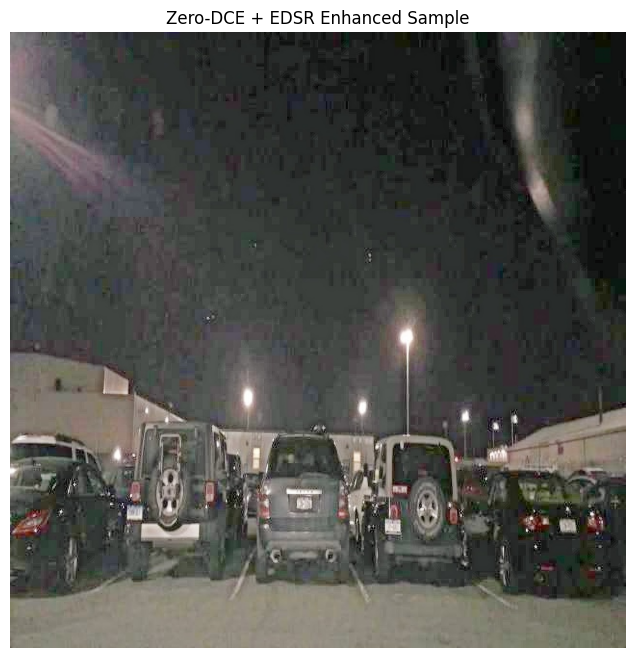

In [ ]:
#4. zero-dce+EDSR 결과눈으로 보기
#학습 전, 실제로 이미지가 얼마나 개선되었는지 샘플 한 장 띄우기,나중에 개선 전/후 비교 가능

import cv2
import matplotlib.pyplot as plt

# 아까 확인된 샘플 이미지 경로 사용
sample_path = '/content/bdd100k_enhanced/train/images/4546766f-11149757_jpg.rf.39d1091d249df26832f9479e9b1b835b.jpg'

if os.path.exists(sample_path):
    img = cv2.imread(sample_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(12, 8))
    plt.imshow(img)
    plt.title("Zero-DCE + EDSR Enhanced Sample")
    plt.axis('off')
    plt.show()
else:
    print("⚠️ 샘플 이미지를 찾을 수 없습니다. 경로를 다시 확인해주세요.")



---A100으로 다시 시작하기---



In [ ]:
import os

extract_path = '/content/bdd100k_enhanced'

print("=== 데이터셋 구조 확인 ===\n")

# 최상위 폴더 확인
for item in os.listdir(extract_path):
    item_path = os.path.join(extract_path, item)
    if os.path.isdir(item_path):
        sub_items = os.listdir(item_path)
        print(f"[DIR] {item}/ -> {sub_items[:5]}")
    else:
        print(f"[FILE] {item}")

# train/valid/test images 확인
print("\n=== 이미지 수 확인 ===\n")

for split in ['train', 'valid', 'test']:
    img_path = os.path.join(extract_path, split, 'images')
    lbl_path = os.path.join(extract_path, split, 'labels')

    if os.path.exists(img_path):
        num_img = len(os.listdir(img_path))
        num_lbl = len(os.listdir(lbl_path)) if os.path.exists(lbl_path) else 0
        print(f"[O] {split}: {num_img} images, {num_lbl} labels")
    else:
        # 중첩 폴더 확인
        nested_path = os.path.join(extract_path, os.listdir(extract_path)[0], split, 'images')
        if os.path.exists(nested_path):
            print(f"[!] {split}: 중첩 폴더에 있음")
        else:
            print(f"[X] {split}: 없음")

=== 데이터셋 구조 확인 ===

[DIR] train/ -> ['images', 'labels']
[DIR] test/ -> ['images', 'labels']
[FILE] data.yaml
[DIR] valid/ -> ['images', 'labels']

=== 이미지 수 확인 ===

[O] train: 27445 images, 27445 labels
[O] valid: 4394 images, 4394 labels
[O] test: 60 images, 60 labels


In [ ]:
import yaml
from ultralytics import YOLO

extract_path = '/content/bdd100k_enhanced'

# 1. YAML 파일 생성
data_yaml = {
    'path': extract_path,
    'train': 'train/images',
    'val': 'valid/images',
    'test': 'test/images',
    'nc': 2,
    'names': ['Vehicle', 'Pedestrian']
}

with open('/content/data_enhanced.yaml', 'w') as f:
    yaml.dump(data_yaml, f)

print("YAML 생성 완료!")

# 2. YOLO 학습 (A100 최적화)
print("\n학습 시작...")
model = YOLO('yolo11s.pt')
model.train(
    data='/content/data_enhanced.yaml',
    epochs=20,
    imgsz=1280,
    batch=16,
    name='yolo11_zerodce_edsr',
    device=0,
    workers=8,
    cache=True,         # 첫 epoch 후 빨라짐
)

print("\n학습 완료!")

YAML 생성 완료!

학습 시작...
Ultralytics 8.4.2 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data_enhanced.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=1280, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=yolo11_zerodce_edsr, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=Tru


--- Model Testing ---
Ultralytics 8.4.2 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11s summary (fused): 101 layers, 9,413,574 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2443.8±1003.3 MB/s, size: 274.4 KB)
val: Scanning /content/bdd100k_enhanced/test/labels... 60 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 60/60 1.4Kit/s 0.0s
val: New cache created: /content/bdd100k_enhanced/test/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 1.1it/s 3.7s
                   all         60        649      0.807      0.671      0.742      0.391
               Vehicle         60        635       0.81      0.628      0.771      0.441
            Pedestrian          9         14      0.805      0.714      0.713       0.34
Speed: 14.8ms preprocess, 9.1ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to /content/runs/detect/va

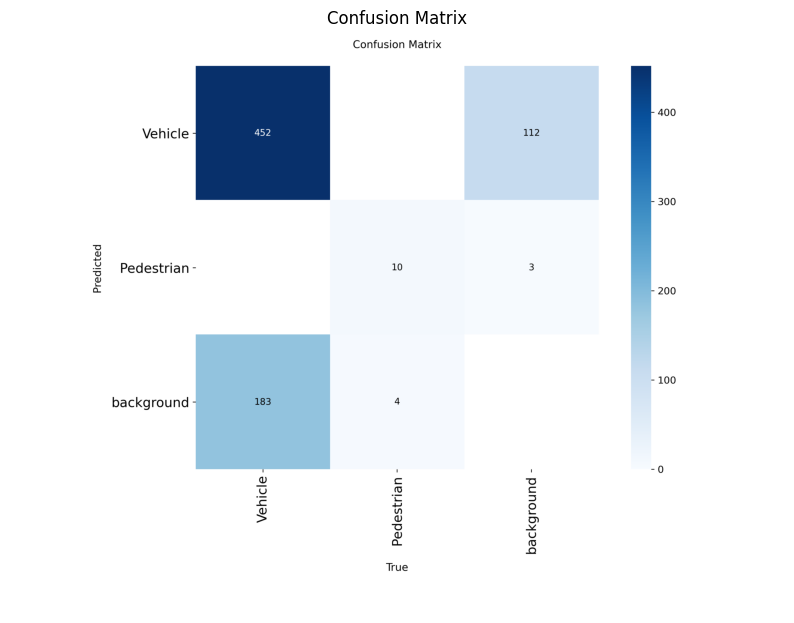

In [ ]:

print("\n--- Model Testing ---")
from ultralytics import YOLO
import matplotlib.pyplot as plt
import os
import cv2

# 1. Load the best trained model
test_model = YOLO('/content/runs/detect/yolo11_zerodce_edsr/weights/best.pt')

# 2. Evaluate the model on the test set
# plots=True: 그래프(PR Curve, Confusion Matrix 등) 저장 활성화
test_results = test_model.val(data='/content/data_enhanced.yaml', split='test', plots=True)

print("✅ Model testing complete.")

# --- 3. 수치 결과 출력 (Recall, Precision, mAP) ---
print("\n[Evaluation Metrics]")
print(f"Mean Precision (mp): {test_results.box.mp:.4f}")
print(f"Mean Recall (mr):    {test_results.box.mr:.4f}")
print(f"mAP@50:              {test_results.box.map50:.4f}")
print(f"mAP@50-95:           {test_results.box.map:.4f}")

# --- 4. 시각화 결과 출력 (저장된 이미지 불러오기) ---
# val()이 결과를 저장한 경로 가져오기
save_dir = test_results.save_dir

def show_result_image(filename, title):
    path = os.path.join(save_dir, filename)
    if os.path.exists(path):
        img = cv2.imread(path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')
        plt.show()
    else:
        print(f"⚠️ {filename} not found in {save_dir}")

print("\n--- Visualizations ---")
# 주요 그래프 시각화
show_result_image('PR_curve.png', 'Precision-Recall Curve') # PR 곡선
show_result_image('F1_curve.png', 'F1-Score Curve')         # F1 스코어 곡선
show_result_image('confusion_matrix.png', 'Confusion Matrix') # 혼동 행렬
# 필요하다면 P_curve.png (Precision), R_curve.png (Recall)도 추가 가능


In [ ]:

# 모델 저장
import shutil
import os

# 1. 원본 파일 경로 (User가 제공한 경로)
source_path = '/content/runs/detect/yolo11_zerodce_edsr/weights/best.pt'

# 2. 저장할 구글 드라이브 경로 (파일명 변경 가능)
# 예: /content/drive/MyDrive/MyAI/models 폴더에 'my_yolo_final.pt'로 저장
save_dir = '/content/drive/MyDrive/yolo11s_zerodce_edsr_260115/models'
save_name = 'yolov11s_2class_zerodce_edsr.pt' # 원하는 이름으로 바꾸세요
destination_path = os.path.join(save_dir, save_name)

# 3. 폴더가 없으면 생성
os.makedirs(save_dir, exist_ok=True)

# 4. 복사 실행
shutil.copy(source_path, destination_path)
print(f"모델 복사 완료: {destination_path}")


모델 복사 완료: /content/drive/MyDrive/yolo11s_zerodce_edsr_260115/models/yolov11s_2class_zerodce_edsr.pt


결과 탐색 경로: /content/runs/detect/yolo11_zerodce_edsr


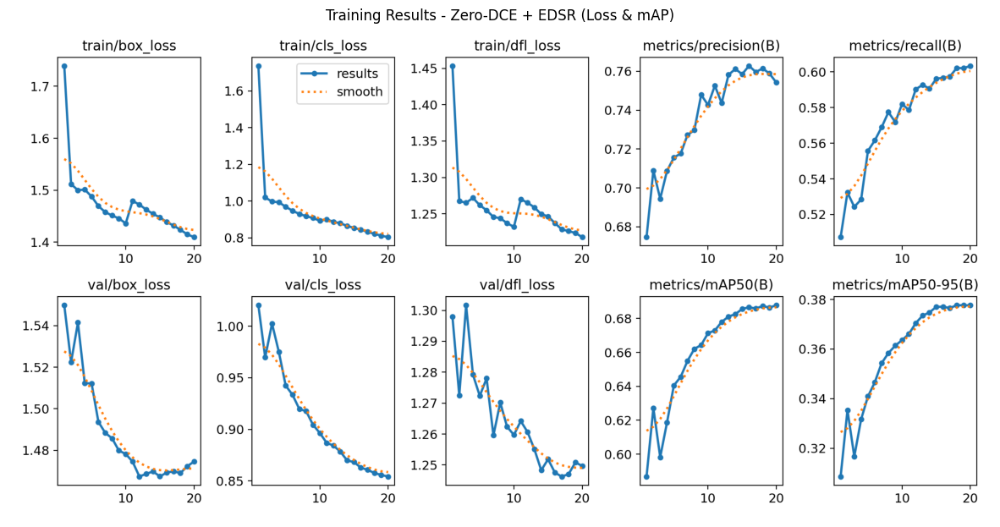

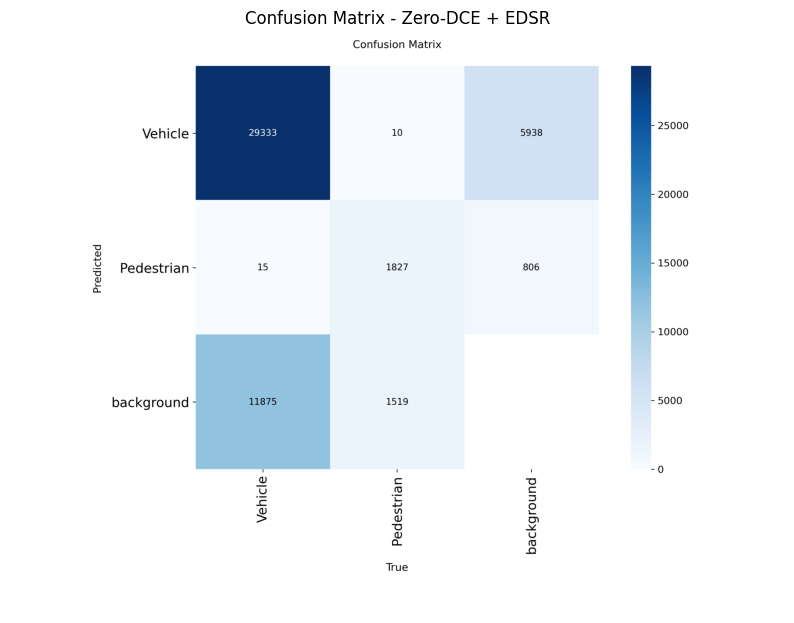


0: 1280x1280 12 Vehicles, 17.6ms
1: 1280x1280 18 Vehicles, 1 Pedestrian, 17.6ms
2: 1280x1280 10 Vehicles, 17.6ms
3: 1280x1280 13 Vehicles, 17.6ms
4: 1280x1280 11 Vehicles, 17.6ms
Speed: 7.2ms preprocess, 17.6ms inference, 0.9ms postprocess per image at shape (1, 3, 1280, 1280)
Results saved to /content/runs/detect/predict2

[야간 도로 탐지 결과 - Zero-DCE + EDSR]

0711ab13-56b31255_jpg.rf.74ca25d4208a37d96c17e6aa46c38dc4.jpg


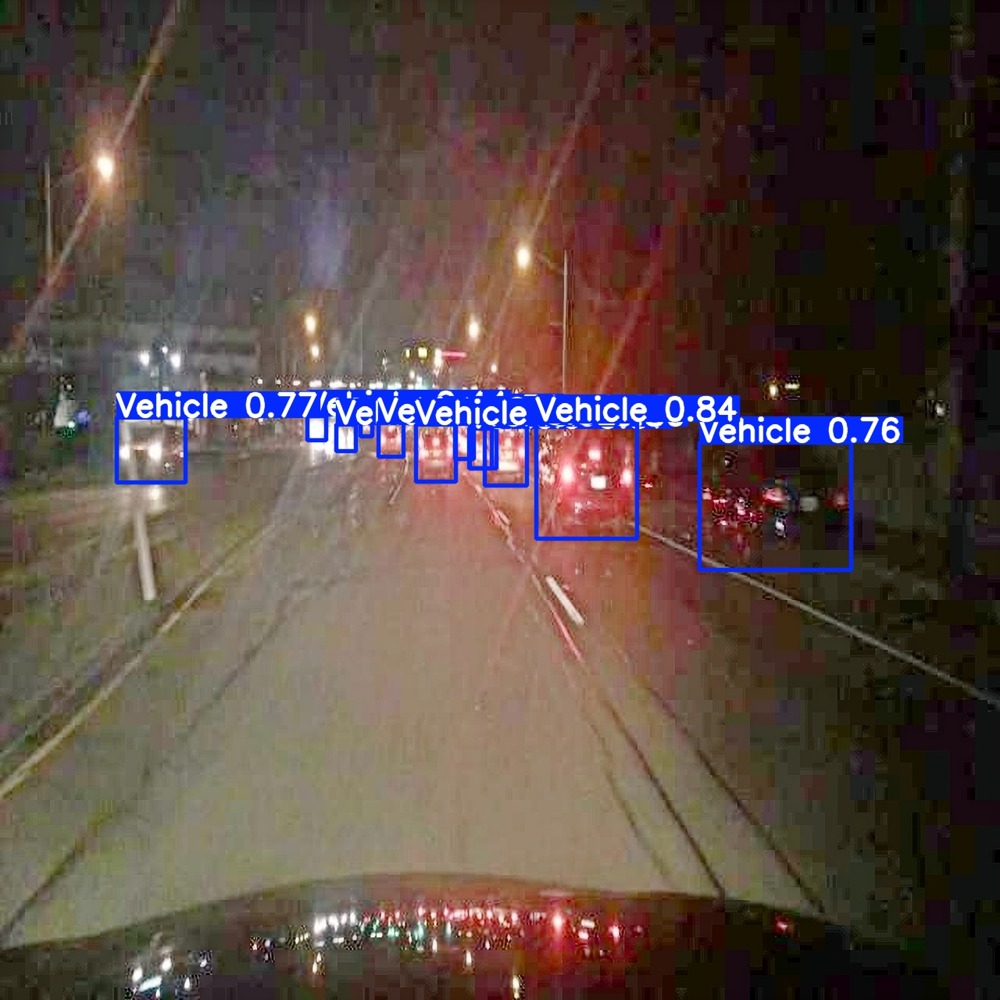


06ea2cc4-62a501af_jpg.rf.43c01151c2331e09a663324078c2ed2c.jpg


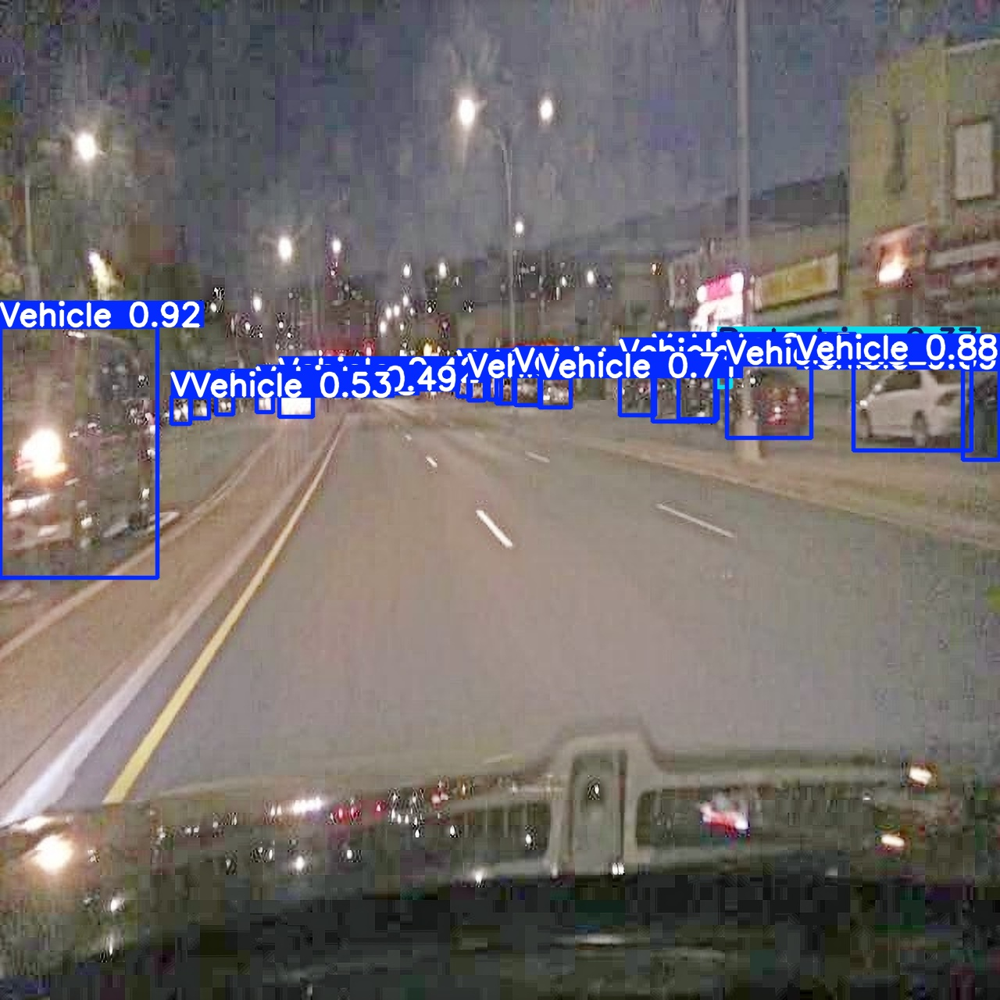


06d501fd-73489e78_jpg.rf.67b94defc7d68e2712dba79895c32053.jpg


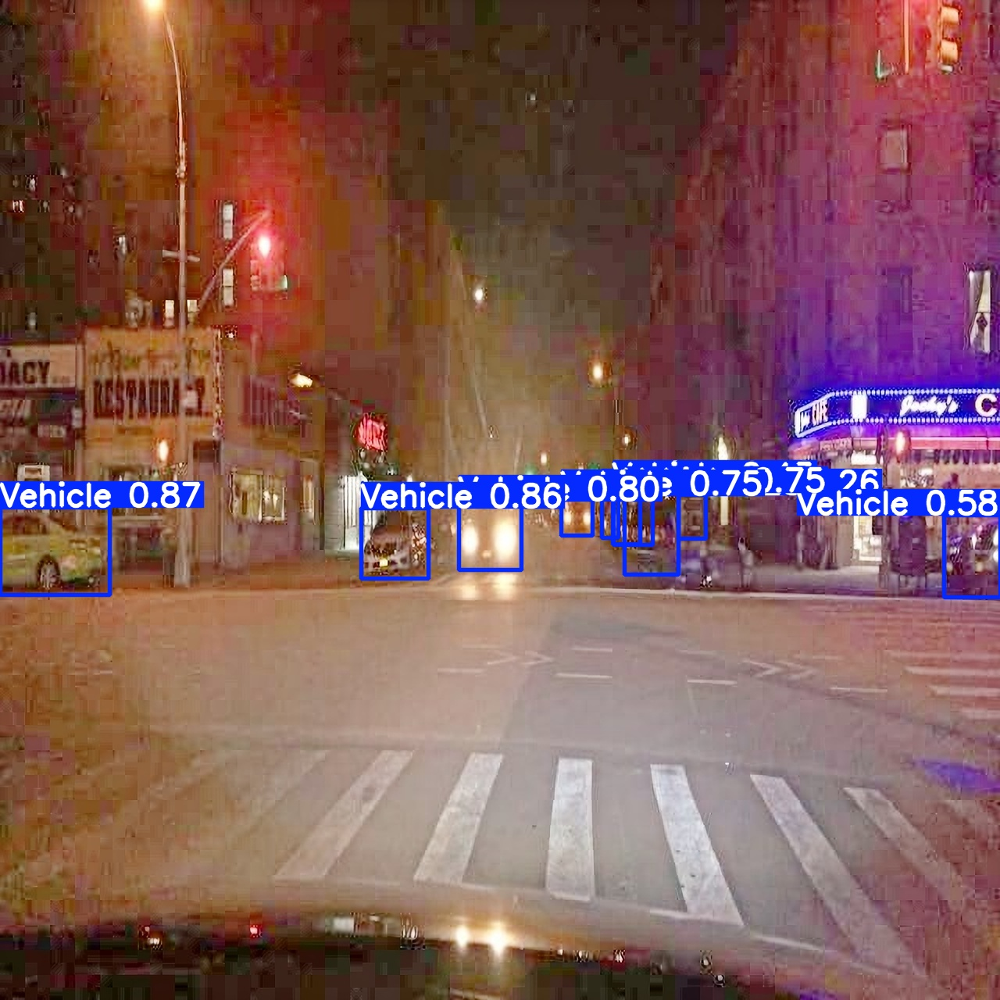


07184fbb-33a15da2_jpg.rf.46cc8455a30a3fb3693f7b4674ba43b1.jpg


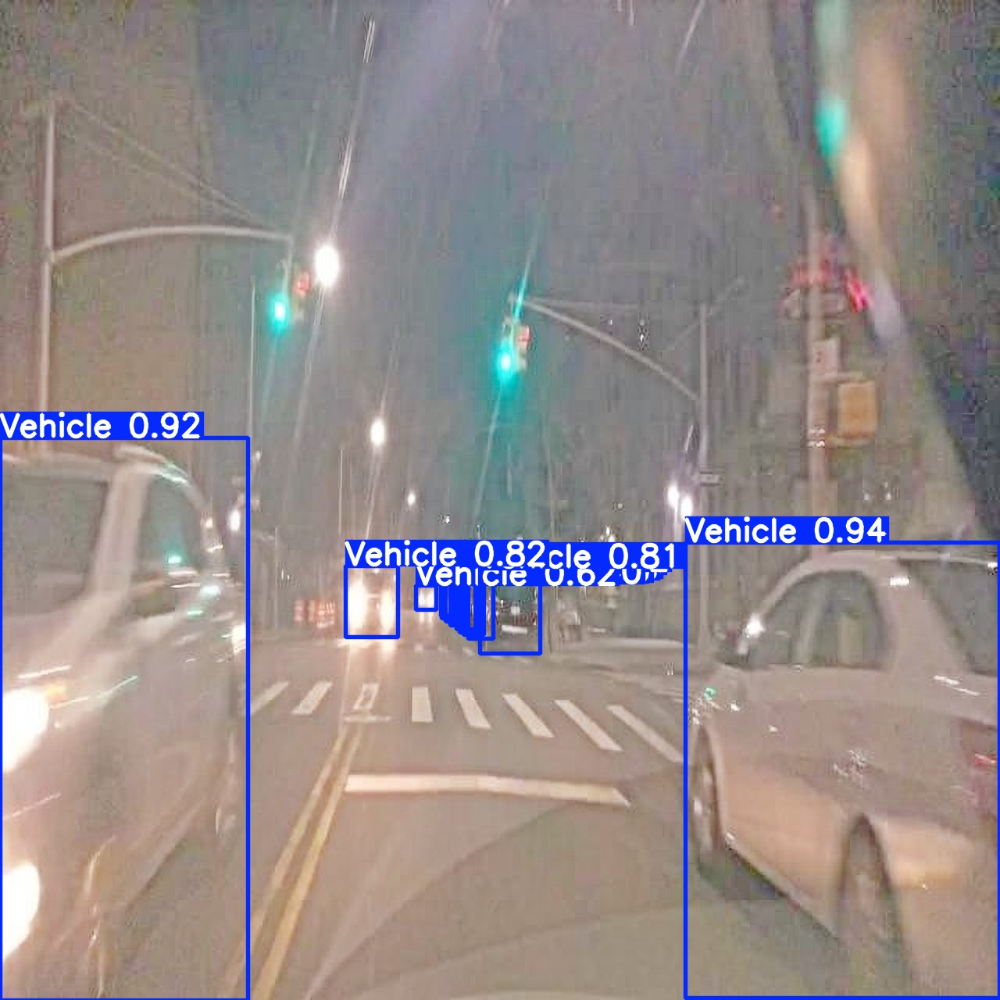


06ca4b52-6fc89b9d_jpg.rf.4e6d8934d83159c9df59604a468a727f.jpg


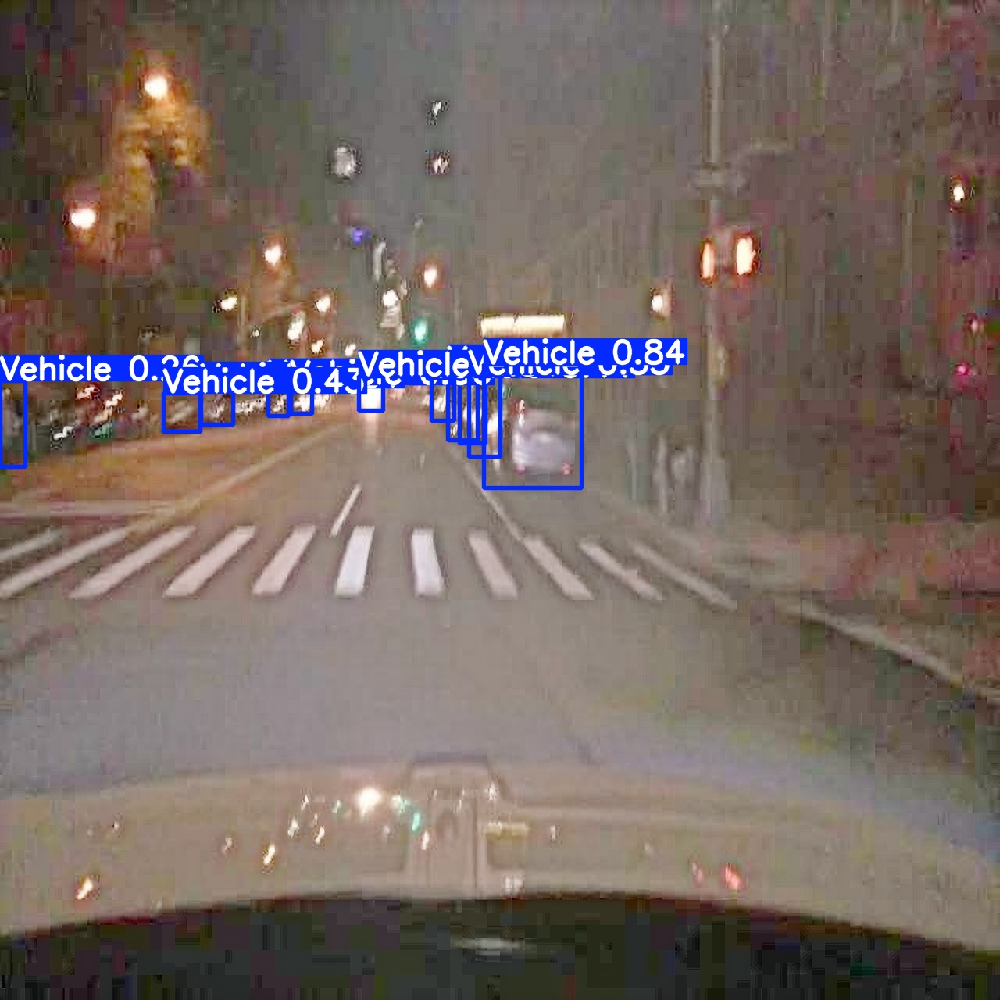


=== 저장된 결과 파일 목록 ===
  [FILE] BoxR_curve.png (154.5 KB)
  [FILE] confusion_matrix_normalized.png (122.0 KB)
  [FILE] confusion_matrix.png (128.4 KB)
  [FILE] train_batch1.jpg (615.2 KB)
  [FILE] val_batch1_labels.jpg (686.4 KB)
  [FILE] train_batch17161.jpg (583.8 KB)
  [FILE] val_batch2_pred.jpg (751.1 KB)
  [DIR] weights/
  [FILE] BoxF1_curve.png (153.3 KB)
  [FILE] train_batch0.jpg (646.8 KB)
  [FILE] labels.jpg (99.4 KB)
  [FILE] args.yaml (1.5 KB)
  [FILE] train_batch2.jpg (616.7 KB)
  [FILE] val_batch0_labels.jpg (686.1 KB)
  [FILE] results.csv (3.7 KB)
  [FILE] train_batch17160.jpg (562.4 KB)
  [FILE] val_batch1_pred.jpg (696.8 KB)
  [FILE] results.png (275.7 KB)
  [FILE] BoxP_curve.png (137.8 KB)
  [FILE] BoxPR_curve.png (155.3 KB)
  [FILE] val_batch0_pred.jpg (690.6 KB)
  [FILE] val_batch2_labels.jpg (748.9 KB)
  [FILE] train_batch17162.jpg (578.3 KB)


In [ ]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ultralytics import YOLO
from google.colab.patches import cv2_imshow
import cv2
import shutil
from google.colab import drive

# 1. 학습 결과 폴더 경로 (현재 학습 결과)
results_dir = '/content/runs/detect/yolo11_zerodce_edsr'

print(f"결과 탐색 경로: {results_dir}")

# 2. 학습 결과 그래프 시각화
result_img = os.path.join(results_dir, 'results.png')
if os.path.exists(result_img):
    img = mpimg.imread(result_img)
    plt.figure(figsize=(15, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title('Training Results - Zero-DCE + EDSR (Loss & mAP)')
    plt.show()
else:
    print("results.png 파일을 찾을 수 없습니다.")

# 3. Confusion Matrix 시각화
confusion_img = os.path.join(results_dir, 'confusion_matrix.png')
if os.path.exists(confusion_img):
    img = mpimg.imread(confusion_img)
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title('Confusion Matrix - Zero-DCE + EDSR')
    plt.show()

# 4. PR Curve 시각화
pr_img = os.path.join(results_dir, 'PR_curve.png')
if os.path.exists(pr_img):
    img = mpimg.imread(pr_img)
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title('PR Curve - Zero-DCE + EDSR')
    plt.show()

# 5. F1 Curve 시각화
f1_img = os.path.join(results_dir, 'F1_curve.png')
if os.path.exists(f1_img):
    img = mpimg.imread(f1_img)
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title('F1 Curve - Zero-DCE + EDSR')
    plt.show()

# 6. 모델 로드 및 테스트 이미지 추론
weights_path = os.path.join(results_dir, 'weights/best.pt')
test_img_dir = '/content/bdd100k_enhanced/test/images'

if os.path.exists(weights_path):
    best_model = YOLO(weights_path)

    # 테스트 이미지 5장 추론
    test_images = [os.path.join(test_img_dir, img) for img in os.listdir(test_img_dir)[:5]]
    results = best_model.predict(source=test_images, save=True, conf=0.25)

    # 결과가 저장된 predict 폴더 찾기
    predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
    latest_predict = predict_folders[-1]

    print("\n[야간 도로 탐지 결과 - Zero-DCE + EDSR]")
    for img_name in os.listdir(latest_predict):
        img_path = os.path.join(latest_predict, img_name)
        img = cv2.imread(img_path)
        if img is not None:
            print(f"\n{img_name}")
            cv2_imshow(img)
else:
    print(f"모델 파일을 찾을 수 없습니다: {weights_path}")

# 7. 결과 파일 목록 확인
print("\n=== 저장된 결과 파일 목록 ===")
for item in os.listdir(results_dir):
    item_path = os.path.join(results_dir, item)
    if os.path.isfile(item_path):
        size = os.path.getsize(item_path) / 1024
        print(f"  [FILE] {item} ({size:.1f} KB)")
    else:
        print(f"  [DIR] {item}/")

=== 보행자(Pedestrian) 탐지 성공 이미지 찾는 중... ===

총 9개 이미지에서 보행자 탐지 성공!

=== 보행자 탐지 결과 (신뢰도 높은 순) ===

06ca4b52-4234312a_jpg.rf.5e46c77cea657f010ea25eb4cce70b18.jpg
  - 탐지된 보행자: 3명
  - 최대 신뢰도: 0.788
  - 평균 신뢰도: 0.707


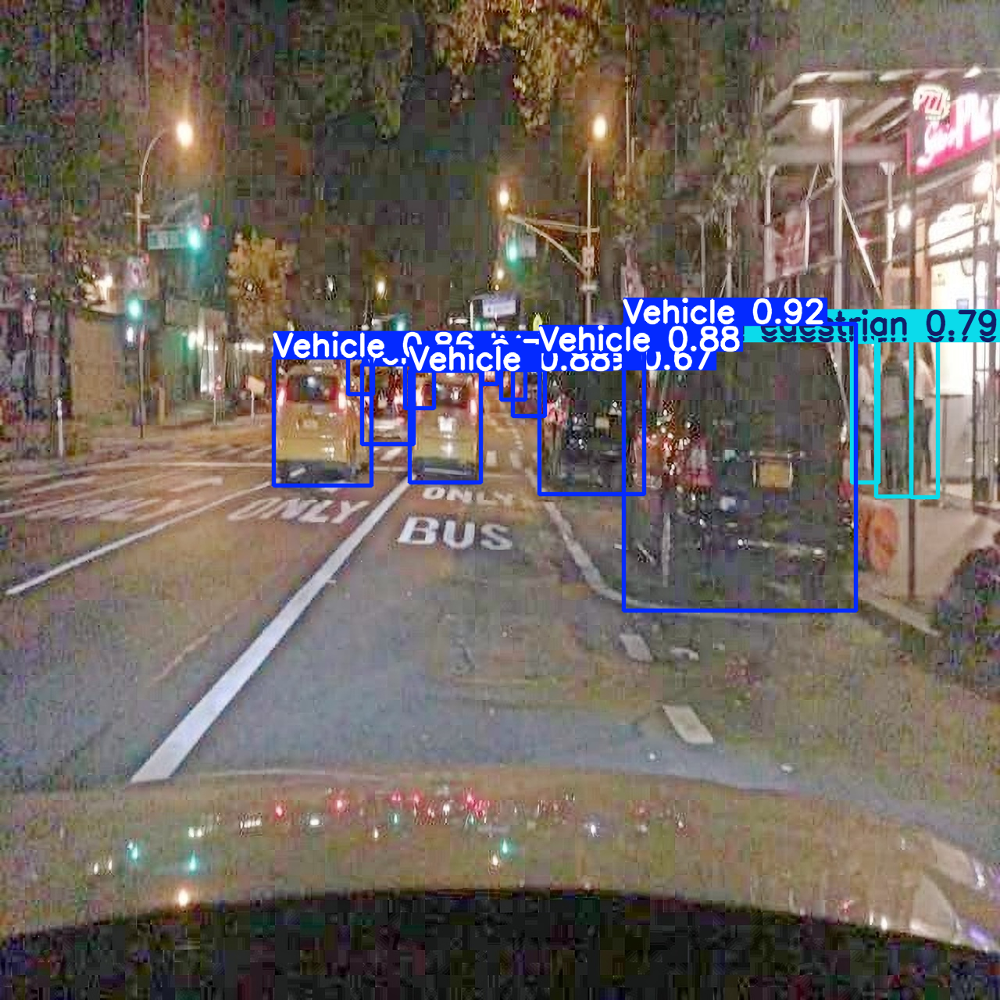


0711ab13-ff3633ab_jpg.rf.c3898f46b96058b7f0886126a9e051a8.jpg
  - 탐지된 보행자: 1명
  - 최대 신뢰도: 0.697
  - 평균 신뢰도: 0.697


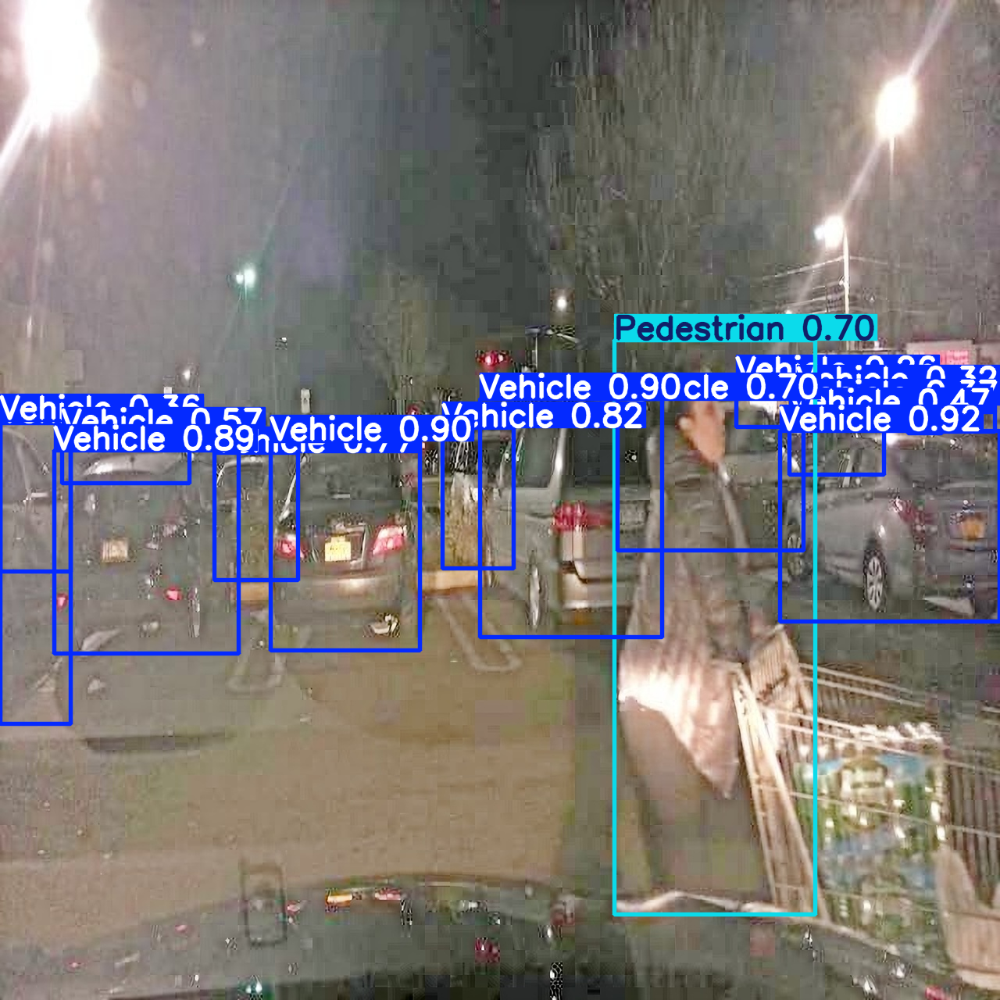


07184fbb-1bf770ba_jpg.rf.9890647eddcceda4fb044d5b7c0f7c6a.jpg
  - 탐지된 보행자: 1명
  - 최대 신뢰도: 0.693
  - 평균 신뢰도: 0.693


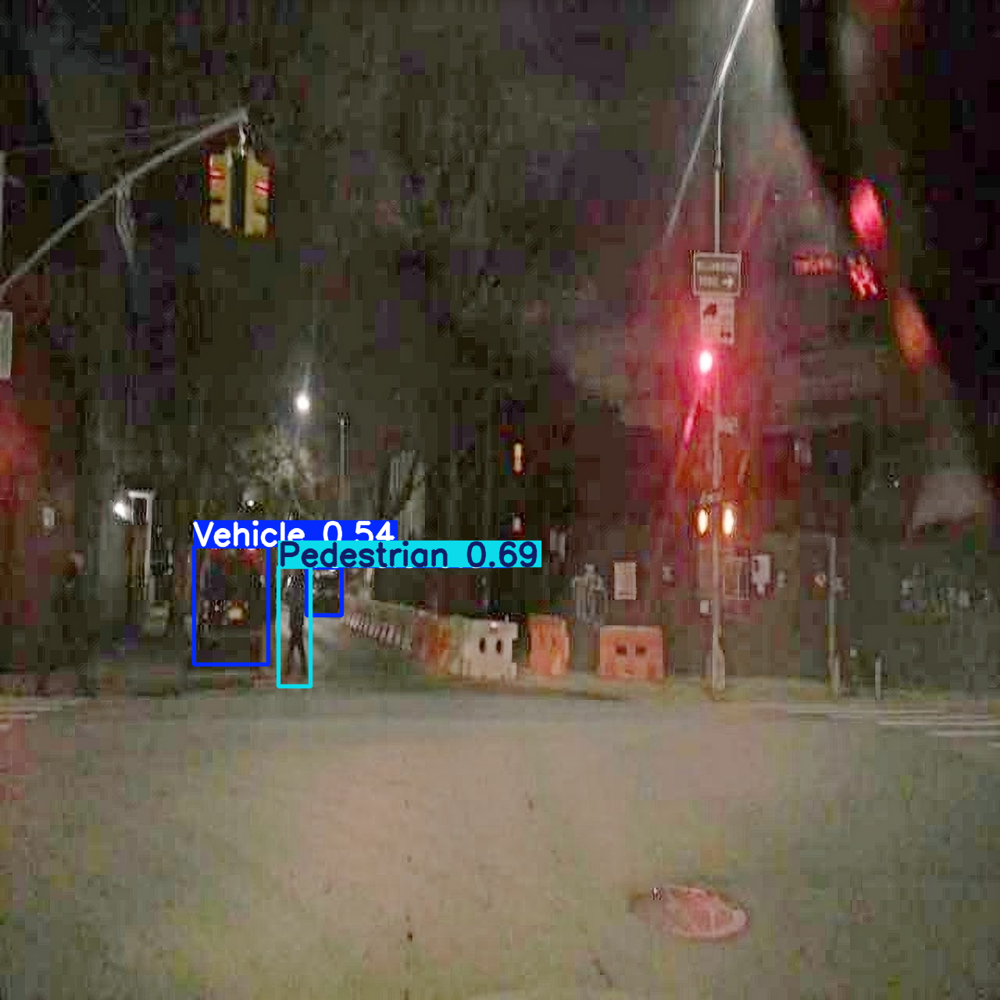


07184fbb-54f9d99d_jpg.rf.251acc401a3e8844c88e6c8d607dcf26.jpg
  - 탐지된 보행자: 1명
  - 최대 신뢰도: 0.421
  - 평균 신뢰도: 0.421


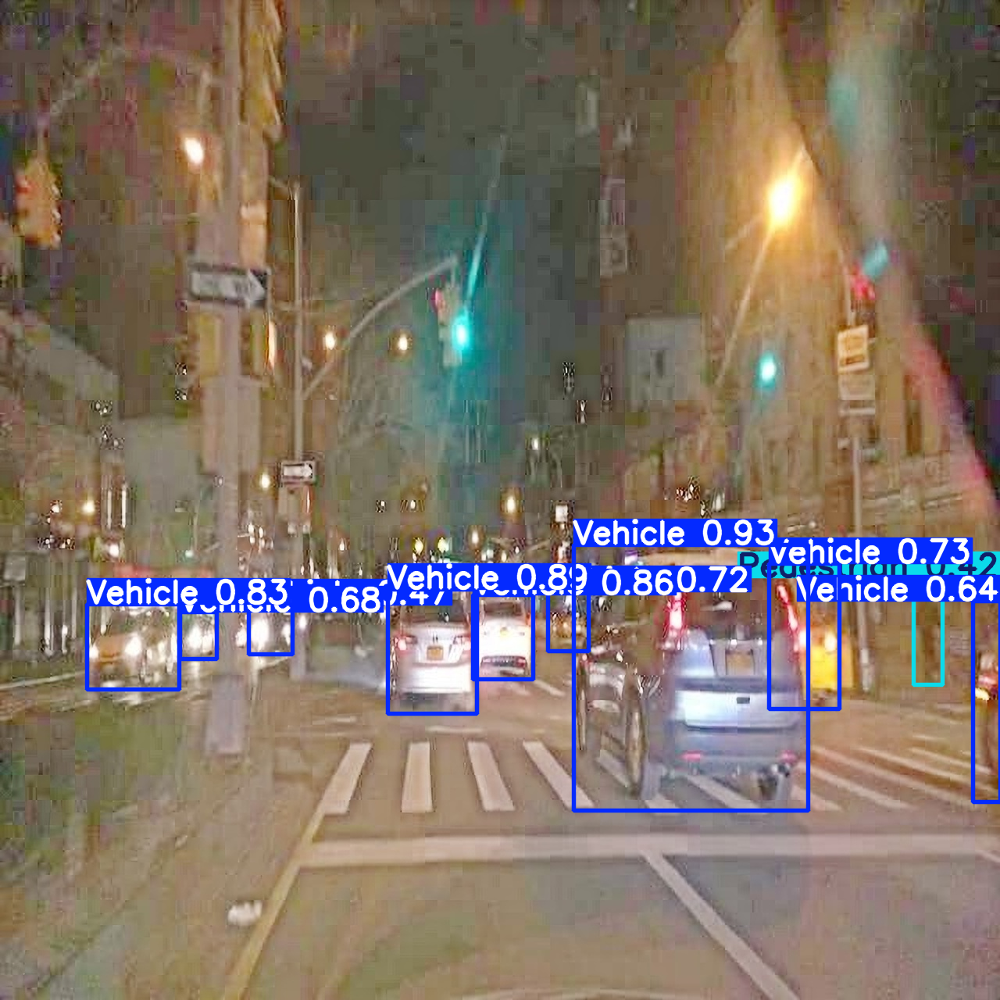


06ea2cc4-62a501af_jpg.rf.43c01151c2331e09a663324078c2ed2c.jpg
  - 탐지된 보행자: 1명
  - 최대 신뢰도: 0.374
  - 평균 신뢰도: 0.374


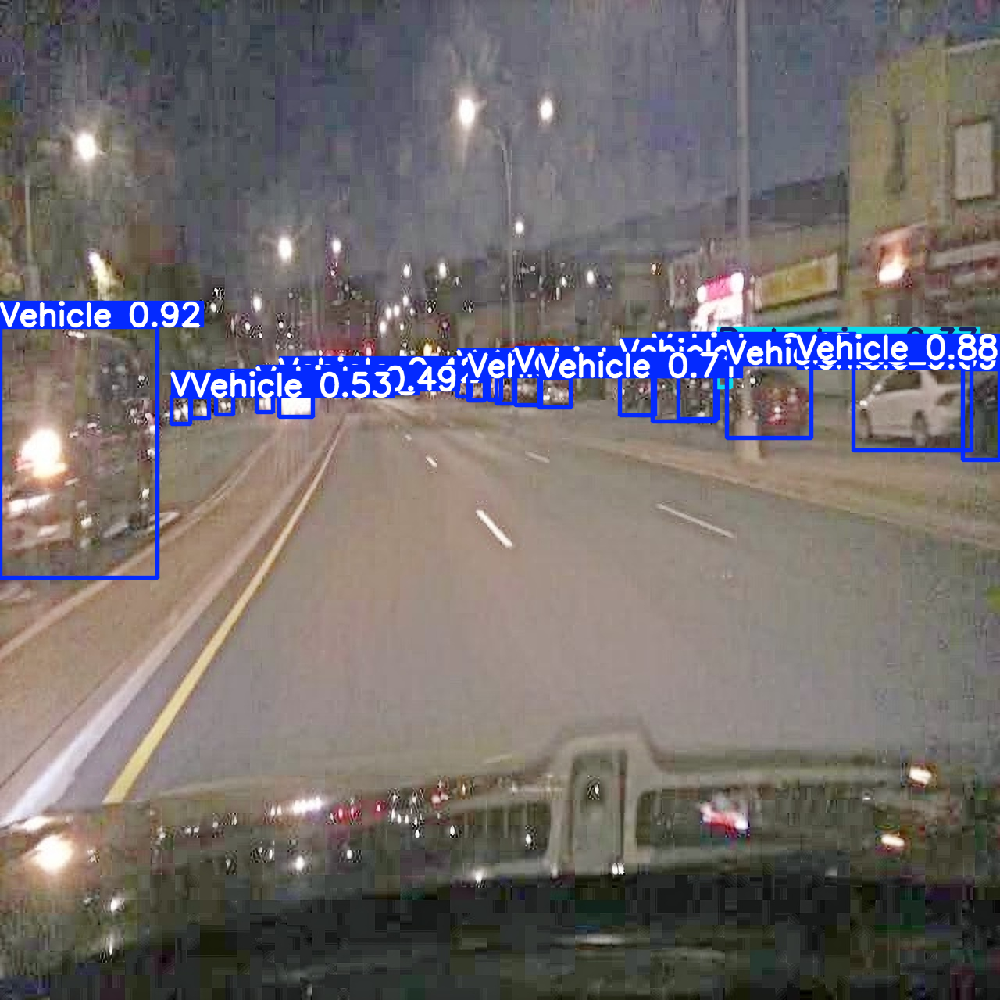

In [ ]:
import os
from ultralytics import YOLO
from google.colab.patches import cv2_imshow
import glob

# 모델 로드
weights_path = '/content/runs/detect/yolo11_zerodce_edsr/weights/best.pt'
model = YOLO(weights_path)

# 테스트 이미지 경로
test_img_dir = '/content/bdd100k_enhanced/test/images'

print("=== 보행자(Pedestrian) 탐지 성공 이미지 찾는 중... ===\n")

pedestrian_detected = []

for img_name in os.listdir(test_img_dir):
    img_path = os.path.join(test_img_dir, img_name)

    # 추론 실행
    results = model.predict(source=img_path, conf=0.25, verbose=False)

    # 탐지된 클래스 확인
    for result in results:
        if result.boxes is not None and len(result.boxes) > 0:
            classes = result.boxes.cls.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()

            # Pedestrian(class 1) 탐지된 경우
            ped_indices = [i for i, c in enumerate(classes) if c == 1]

            if len(ped_indices) > 0:
                ped_confs = [confs[i] for i in ped_indices]
                avg_conf = sum(ped_confs) / len(ped_confs)
                pedestrian_detected.append({
                    'path': img_path,
                    'name': img_name,
                    'count': len(ped_indices),
                    'avg_conf': avg_conf,
                    'max_conf': max(ped_confs)
                })

# 신뢰도 높은 순으로 정렬
pedestrian_detected.sort(key=lambda x: x['max_conf'], reverse=True)

print(f"총 {len(pedestrian_detected)}개 이미지에서 보행자 탐지 성공!\n")

# 상위 5개 시각화 (신뢰도 높은 순)
print("=== 보행자 탐지 결과 (신뢰도 높은 순) ===\n")

for item in pedestrian_detected[:5]:
    results = model.predict(source=item['path'], conf=0.25, save=False, verbose=False)
    annotated_img = results[0].plot()

    print(f"{item['name']}")
    print(f"  - 탐지된 보행자: {item['count']}명")
    print(f"  - 최대 신뢰도: {item['max_conf']:.3f}")
    print(f"  - 평균 신뢰도: {item['avg_conf']:.3f}")
    cv2_imshow(annotated_img)
    print("")



---

